# Maze Runner

*AI functions can navigate mazes*

In this tutorial, we're going to walk you through how AI functions can interact with games using simply images from the game. To do this, we will use OpenAI's [Procgen Benchmark](https://openai.com/index/procgen-benchmark/), specifically the 2D maze environment and [AI functions](https://www.aifunction.com/) by Weco. We'll build an agent that uses AI functions at it's core. Lets jump right in!

You can follow along through the code and also watch our quick demo on the same [here](https://www.youtube.com/embed/DLZ6lhxAFYU).
<iframe width="640" height="360" src="https://www.youtube.com/embed/DLZ6lhxAFYU" frameborder="0" allowfullscreen></iframe>

<a href="https://colab.research.google.com/github/WecoAI/aifn-python/blob/main/examples/maze_runner.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab" width=110 height=20/></a>
<a target="_blank" href="https://lightning.ai/new?repo_url=https%3A%2F%2Fgithub.com%2FWecoAI%2Faifn-python%2Fblob%2Fmain%2Fexamples%2Fmaze_runner.ipynb"><img src="https://pl-bolts-doc-images.s3.us-east-2.amazonaws.com/app-2/studio-badge.svg" alt="Open in Studio" width=100 height=20/></a>

## Dependencies

In [ ]:
%%capture
!apt-get update -qq
!apt-get install -y software-properties-common
!add-apt-repository ppa:openjdk-r/ppa -y
!apt-get update -qq
!apt-get install -y xvfb python3-opengl ffmpeg
!pip install --no-cache-dir aifn Pillow gym procgen pyvirtualdisplay

In [ ]:
import io
from datetime import datetime
import base64
from copy import deepcopy
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import clear_output
from pyvirtualdisplay import Display
from procgen import ProcgenEnv
from aifn import AIFunction
import warnings
warnings.filterwarnings("ignore")

## Setup Game

In [ ]:
def show_frame(observation, log_history):
    """Helper function to display the current frame and command log."""
    clear_output(wait=True)
    fig = plt.figure(figsize=(10, 7))
    gs = fig.add_gridspec(1, 2, width_ratios=[3, 1])
    ax_left = fig.add_subplot(gs[0])
    ax_left.imshow(observation['rgb'][0])
    ax_left.axis('off')
    ax_right = fig.add_subplot(gs[1])
    ax_right.axis('off')
    ax_right.set_facecolor('#f7f7f7')
    ax_right.set_title("Command Log", loc='center', fontsize=12, pad=10, color='black')
    log_text = "\n".join("> " + s for s in log_history)
    ax_right.text(0, 1, log_text, ha='left', va='top', fontsize=10, family='monospace', color='black', wrap=True)
    plt.tight_layout()
    plt.show()

In [ ]:
%%capture
display = Display(visible=0, size=(1400, 900))
display.start()

In [ ]:
# Create our game environment
env = ProcgenEnv(num_levels=1, start_level=20, use_backgrounds=False, distribution_mode="easy", num_envs=1, env_name="maze")

## Build Agent

First, head on over to our [platform](https://www.aifunction.com/function/new) and create an AI function with the following description:
> You are a grey blob navigating a treacherous 2D maze. Your only way out is to follow the dark road that leads to the orange exit. Return an 'action' that follows the path leading to the exit. Use 1 for left, 7 for right, 5 for up and 3 for down.

<!-- ![Maze Runner GIFs.gif](../docs/assets/maze_runner_create_fn.gif) -->
![Maze Runner GIFs.gif](<attachment:Maze Runner GIFs.gif>)
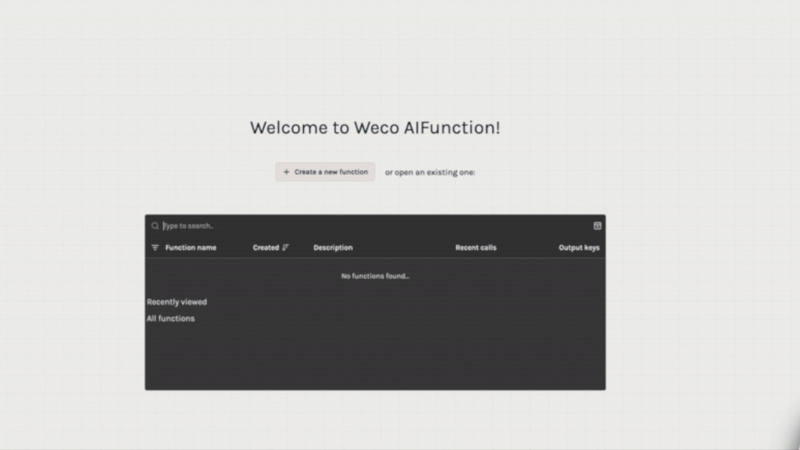

Then grab the function name and come right back here to bring your agent to life!

![Maze Runner GIFs Copy Function Name.gif](<attachment:Maze Runner GIFs cpy fn.gif>)
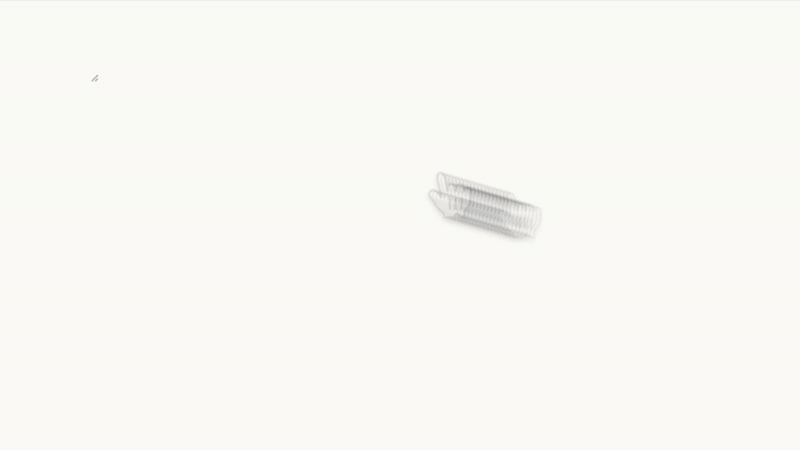

We now define a class that uses an AI function at it's very core. The agent here is a simple wrapper around our AI function to provide a more agentic like interface for the game we are about to play. The core function takes in an observation (image), preprocesses this image and passes it to our AI function. The AI function then analyzes the image and returns a simple response. We can then extract and perform the action based on the AI function's judgement.

In [ ]:
class Agent:
    def __init__(self, fn_name, api_key):
        # Initialize your AI function
        self.get_action = AIFunction(fn_name=fn_name, api_key=api_key)

    def __repr__(self): return str(self.get_action)
    def __str__(self): return str(self.get_action)

    def act(self, observation):
        # Preprocess the observation
        resized_image = Image.fromarray(deepcopy(observation)['rgb'][0].astype(np.uint8)).resize((1024, 1024))
        buffer = io.BytesIO()
        resized_image.save(buffer, format="jpeg")
        images = [f"data:image/jpeg;base64,{base64.b64encode(buffer.getvalue()).decode('utf-8')}"]
        action = self.get_action(images_input=images).output["action"]
        return action

    def action_to_command(self, action):
        action_space = {1: "left", 7: "right", 5: "up", 3: "down"}
        return action_space.get(action, "unknown")

In [ ]:
# NOTE: Don't forget to set these!
api_key = "YOUR_API_KEY"
fn_name = "YOUR_AI_FUNCTION_NAME"

# Initialize our agent that uses an AI function as its brain
agent = Agent(fn_name, api_key)
print(f"Agent {agent} is on the job!")

## Play the Game!

Now you're ready to play the game!

In [ ]:
# We'll give the agent 20 timesteps to navigate the maze but you could give it more if you'd like
timesteps = 20
observation = env.reset()

log_history = [f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Agent started navigating the maze"]
show_frame(observation, log_history)

found = False  # Did the agent find the exit yet?
while timesteps > 0:
    # Determine the agent's next move based on the current state of the environment
    action = agent.act(observation)
    # Observe the results of the agent's action by getting the new state of the environment
    observation, _, done, _ = env.step(np.array([action]))
    timesteps -= 1

    log_history.append(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Agent says move {agent.action_to_command(action)}.")
    show_frame(observation, log_history)

    if done[0]:
        # The agent found the exit!
        found = True
        break

log_history.append(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Agent found the exit!" if found else f"Agent did not find the exit.")
show_frame(observation, log_history)

In [ ]:
%%capture
env.close()
display.stop()